<h1>Question 1</h1>

In this question we will briefly compare the three methods for training a neural network, namely Batch, Stochastic, and Mini-Batch Gradient Descent.

First let's define Gradient Descent itself. Gradient Descent is an algorithm that tries to find the minimum of a function in some steps. It's goal in the case of neural networks is to find the minimum of the loss function in two iterative steps:

1.Computing the first-order derivative of the current point in the function(the slope)

2.Moving from the current point to the opposite direction of the slope increase 

In conclusion, the training set is passed through all the layers in the forward pass step and then the weights(parameters)of the layers are updated by the computation of the gradients using the same training set.

Now, to get back to our question; there are three ways to compute the weights:

<h2>1) Batch Gradient Descent</h2>

In this method, in order to take a step, we should consider the entire training samples. The average is computed on all of the gradients of all the training samples and then this mean gradient is used to update the weights. The process described is one step of the algorithm in a single epoch.

It is said that this method is mainly used when the error manifolds are convex or somewhat smooth as this leads us directly towards an optimal answer.

<img src='Batch.PNG'>

Source of image: https://www.bogotobogo.com/python/scikit-learn/scikit-learn_batch-gradient-descent-versus-stochastic-gradient-descent.php

<h2>2) Stochastic Gradient Descent</h2>

The first method is not suitable for cases where we have a very huge training set. This usually does happen in neural networks because very big amounts of training examples gives us better models. In this case if we want to use the first method we'll have to calculate gradients of many samples(e.g. one million samples) in every epoch. That's why it's not efficient and we need another method in such cases.

That's why we use Stochastic Gradient Descent. In this method, instead of considering all the examples in every step, we just consider one example at a time in every step. We take a single example, feed it to the network, calculate it's gradient and use that to update the weights. We then repeat the process for every training sample.

As we consider an example at a time we know that the cost function will not necessarily decrease and will swing around the samples. But after a long time and running the algorithm several times we will eventually see the cost decreasing with the swings.

Another thing to consider is that the swings of the cost cause it to never reach the minima, but instead the cost function will dance around it and will always be near the minima. 

We mainly use this method in bery large datasets because it converges faster. The reason is that updates to the weights happen more frequently.



<img src='Stochastic.PNG'>

Source of image: https://adventuresinmachinelearning.com/stochastic-gradient-descent/

<h2>3) Mini-Batch Gradient Descent</h2>

As concluded above, the first algorithm is used for smoother curves and converges directly to the omptimum. The second algorithm is used for large datasets and converges faster.

There is only one problem in the second method. Since we use one example at a time, we can't do a vectorized implementation on it and that leads to slow computations. That's why Mini-Batch Gradient Descent is used.

This method is a combination of the previous methods. We don't consider the whole training samples but we also don't consider one example at a time. We use a fixed number of the training samples(a batch) which is less than the whole datadet and is called a mini-batch. This way we can gain the advatages of both of the previous methods. 

So the main process is that we choose a mini-batch, feed it to the network, calculate it's mean gradient, and use that to update the weights. The process described is then repeated for all the mini-batches.

Similar to the second method, the cost swings because we are considering a small amount of examples at each step.

In conclusion, in this method the weights are updated frequently and the computations are fast due to vectorized implementation.

<img src='Mini-Batch.PNG'>

Source of image: https://stats.stackexchange.com/questions/310734/why-is-the-mini-batch-gradient-descents-cost-function-graph-noisy

<h1>Question 2</h1>

In this question we'll preprocess the semeion handwritten digits and display some of them. Then, we'll do a train test split and get train,validation, and test sets ready. Afterwards, we'll build a neural network from scratch and train and predict the sets with it.


<h3>Things to Note</h3>

For the neural network part, my code was inspired by a user named 'furkankykc' on github. The source can be found here:
https://github.com/furkankykc/SemeionsHandwrittenDigits/blob/master/NeuralNetwork.py

Of course,the code wasn't just copied and used, but instead, it gave me ideas to implement my own network, and several modifications and changes were done on the code to make it suitable for my project.

At the end of the project, I've also impelented the whole project with Keras and compared the results to see if my work was somewhat correct or not. I'm happy to state that Keras gave me similar results. Of course, the accuracy in Keras was slightly higher compared to the accuracy I obtained from using a neural network built from scratch, but I think that's natural.

Lastly, I haven't used any packages other than numpy in the network, but had to use python's 'pickle' to save the weight variables and use them in different parts of the prediction and training functions in the neural network class. A friend suggested that I could save python sessions without using pickle, with a method called decorators, but due to focussing on the main aspects of this projects I lacked the time to look it up and implement it. So pickle is the only thing I used other than numpy, but it didn't interfere with any parts of designing the network and was merely used to save the weight variables.

With all these stated, I feel comfortable to finally begin the report for this question.

<h3>Preprocessing the Semeion Dataset</h3>

Before doing anything, I'll load the packages necessary for this project.

In [1]:
import numpy as np
import pandas as pd
import pickle
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
import warnings
warnings.filterwarnings('ignore')

First we'll load the dataset and view it's head and shape to see what it looks like:

In [2]:
df = pd.read_csv('semeion.data', delimiter = r"\s+", header=None )
print(df.head())
print(df.shape)

   0    1    2    3    4    5    6    7    8    9    ...  256  257  258  259  \
0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  1.0  ...    1    0    0    0   
1  0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  1.0  1.0  ...    1    0    0    0   
2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  ...    1    0    0    0   
3  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  1.0  ...    1    0    0    0   
4  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  ...    1    0    0    0   

   260  261  262  263  264  265  
0    0    0    0    0    0    0  
1    0    0    0    0    0    0  
2    0    0    0    0    0    0  
3    0    0    0    0    0    0  
4    0    0    0    0    0    0  

[5 rows x 266 columns]
(1593, 266)


According to the UCI, we have 1593 samples(digits) that were written by 80 people, where each person wrote every digit from 0 to 9, once accurately and once in a fast and inaccurate way. The digits were then stretched in a 16x16 box with a gray scale of 256 values. 

So as we can see above, we have 1593 samples, 256 features(pixels) for each digit, and 10 labels that are one hot encoded and show the label of each digit.

We need to seperate the features and the labels from each other. So we'll convert the dataset to a dataframe named X, drop the labels(columns 256 to 265) and store them as features in X.

Next, we'll store columns 256 to 265 from the dataset in a variable y as our target labels, and we'll rename the column names from 256-265 to 0-9 for better understanding.

In [3]:
X = pd.DataFrame(df)
X = X.drop([256,257,258,259,260,261,262,263,264,265], axis=1)
print(type(X))
print(X.shape)
print(X.head())

<class 'pandas.core.frame.DataFrame'>
(1593, 256)
   0    1    2    3    4    5    6    7    8    9    ...  246  247  248  249  \
0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  1.0  ...  1.0  0.0  0.0  0.0   
1  0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  1.0  1.0  ...  1.0  1.0  1.0  1.0   
2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  ...  1.0  0.0  0.0  0.0   
3  0.0  0.0  0.0  0.0  0.0  0.0  1.0  1.0  1.0  1.0  ...  0.0  0.0  0.0  0.0   
4  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  ...  0.0  0.0  0.0  0.0   

   250  251  252  253  254  255  
0  0.0  0.0  0.0  0.0  0.0  0.0  
1  1.0  0.0  0.0  0.0  0.0  0.0  
2  0.0  0.0  0.0  0.0  0.0  0.0  
3  0.0  0.0  0.0  0.0  0.0  0.0  
4  0.0  0.0  0.0  0.0  0.0  0.0  

[5 rows x 256 columns]


In [4]:
label_df = pd.DataFrame(df.iloc[:,[256,257,258,259,260,261,262,263,264,265]])
print(label_df.head())
print(label_df.shape)
label_df.rename(columns={256:0, 257:1, 258:2, 259:3, 260:4, 261:5, 262:6, 263:7, 264:8, 265:9 }, inplace=True)
y = label_df
print(y.head())

   256  257  258  259  260  261  262  263  264  265
0    1    0    0    0    0    0    0    0    0    0
1    1    0    0    0    0    0    0    0    0    0
2    1    0    0    0    0    0    0    0    0    0
3    1    0    0    0    0    0    0    0    0    0
4    1    0    0    0    0    0    0    0    0    0
(1593, 10)
   0  1  2  3  4  5  6  7  8  9
0  1  0  0  0  0  0  0  0  0  0
1  1  0  0  0  0  0  0  0  0  0
2  1  0  0  0  0  0  0  0  0  0
3  1  0  0  0  0  0  0  0  0  0
4  1  0  0  0  0  0  0  0  0  0


Now it's time to visualize the images. For that purpose, we'll write a function called make_image. We know that the index for each digit is stored in X. This function takes an index for a digit as an input, it then finds the row of the digit from X and converts it to a numpy array. Afterwards it takes 16 pixels from X and streches it in a rectangular 16x16 box and lastly it plots the pixels against eachother with color gray, this way it visualizes a single digit. The code for the function is given:

In [5]:
def make_image (index_num):
    one_row = X.ix[index_num] # getting the digit sample from X
    one_values = one_row.values # converting the sample to a numpy array
        
    # taking the necessary pixels for the plotting
    i = 16 # values in one array
    j = 0
    img = np.array(one_values[:16])
    while i <= len(one_values):
        temp_array = np.array(one_values[j:i])
        img = np.vstack((img,temp_array))
        j = i   
        i += 16

    # Plotting the pixels
    plt.imshow(img,cmap=plt.cm.gray_r,interpolation="nearest")
    plt.show()
    return

Now we'll choose digits from 0-9 by their index from X and plot them using make_image. I've tried to pick digits which were written nicely and you could understand what digit it was by looking at it's plot as some of them were really badly written.

So here are our digits from 0 to 9:

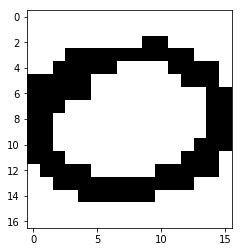

In [6]:
make_image(599)

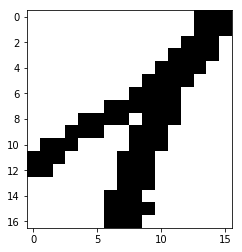

In [7]:
make_image(21)

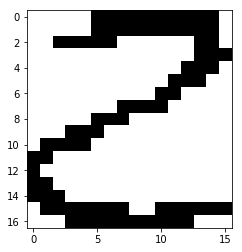

In [8]:
make_image(41)

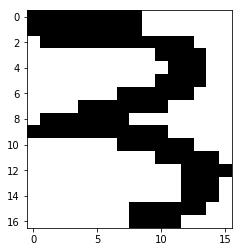

In [9]:
make_image(62)

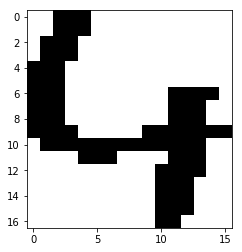

In [10]:
make_image(977)

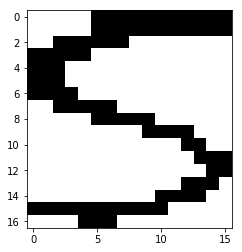

In [11]:
make_image(101)

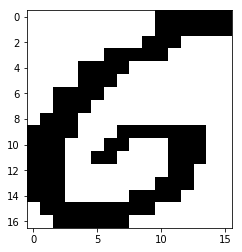

In [12]:
make_image(121)

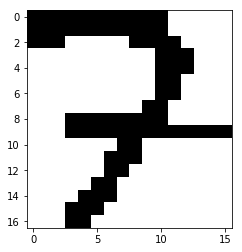

In [13]:
make_image(141)

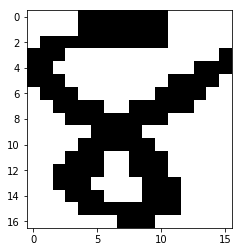

In [14]:
make_image(362)

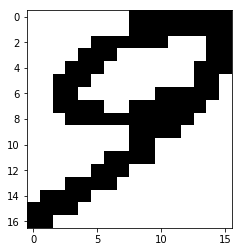

In [15]:
make_image(181)

Now, before the train test split, we'll convert X and y to numpy arrays for easier computations:

In [16]:
X = (np.array(X))
y = (np.array(label_df))
print(type(X))
print(type(y))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


The last step in our preprocessing is to do train test splits with test size and validation size of 0.15 and obtain training,validation, and test sets:

In [17]:
X_train1, X_test, y_train1, y_test = train_test_split(X, y, test_size=0.15, random_state=42)
X_train,X_valid,y_train,y_valid = train_test_split(X_train1,y_train1,test_size=0.15,random_state=42 )

<h3>Neural Network</h3>

The neural network is written in a class named Network. It has 9 functions and below we'll explain what each one does.

1.init: This function is used for initializing the hyper parameters and indicates the parameters that should be specified for the class. The parameters are num_of_nodes_in_layers(which is a list and specifies both the number of layers and the number of nodes in each layer), numb_of_epochs for which we want to run the algorithm, the learning_rate of the algorithm and a weights_file which is a file used by the pickle module to store the weights in different parts of the functions and restore them when necessary. After specifiying the parameters, init initializes them with values that we've given and gets them ready for the next steps. It also gives an inital random weight and bias to the weight and bayas parameters and also initializes the loss and acuracy with 0.

2.train: This is one of the main functions of this class and is the function we'll use when training the model. It takes inputs and labels as input values. That would be the training features and labels that we'll give to this function. After getting the inputs, it first splits the batch set from the inputs and labels(for which the size is known already)and makes them ready for the training. So in this step the batch part gets ready. Then it does a forward pass and passes the batch samples through the network, calculating it's values and getting an output(As I'll explain further below,I've implemented three activation functions relu,softmax,and tanh in this code. After doing many try and errors I obtained the optimal number of layers to be two,with one hidden layer,and the optimal activation functions to be relu for the hidden layer and softmax for the output layer. That's why in the code below I haven't used tanh and have put one hidden layer only. But the code can be changed anytime to have any number of layers and any activation functions as pleased. I've just written the optimal form here). It then calculates the loss using the loss function(explained further below)for the output of the network and also the accuracy. Then it does a backward pass and uses the backpropagation algorithm to calculate the gradient derivatives and also adds L2 Regularization terms to the weights. It then updates the weights and bayas in the mini-batch gradient descent steps and gets everything updated. Lastly,it prints the loss and accuracy in each iteration of every epoch. The last few lines of the code are for saving(dumping)the updated weights using pickle in the weights file.

3.predict: This is another main function of this class and is used for the prediction of our labels. It takes input as it's input value, which is the test set for which we want it's labels predicted. It feeds the input to the different layers of the network and calculates the final output. It returns the output as our final labels. before returning, it plots the error and accuracy of the test set using the drawloss funtion.

4.relu: calculates the relu activation function, that is R(z)=max(0,z)
5.softmax: calculates the relu activation function, that is Si(z)=e^zi/(Σe^zj)
6.tanh: calculates the tanh activation function, that is Tanh(z)=(e^z-e^-z)/(e^z+e^-z)
7.cross_entropy: computes the cross entropy loss function.Cross-entropy,or log loss, measures the performance for a classification model where the output is a probability value in the range of 0-1. When the predicted label probability is different from the real label the loss increases. An ideal model has a log loss of 0.
The formula of cross entropy for multiclass classification is given below:

<img src='Cross entropy.PNG'>

Where M is the number of the classes, y is the actuall label value of the observation o for class c, and p is the predicted probability observation o of class c.

8.L2_regularization: adds a regularization term, here being 0.01 to the weight gradients.
9.drawLoss: plots the loss and accuracy values in each epoch for the test set.     

In [18]:
class Network:

   # Class Hyper Parameter Initialization 
    def __init__(self,
                 num_nodes_in_layers,
                 batch_size,
                 num_epochs,
                 learning_rate,
                 weights_file
                 ):

        self.num_nodes_in_layers = num_nodes_in_layers
        self.batch_size = batch_size
        self.num_epochs = num_epochs
        self.learning_rate = learning_rate
        self.weights_file = weights_file

        self.weight1 = np.random.normal(0, 1, [self.num_nodes_in_layers[0], self.num_nodes_in_layers[1]])
        self.bias1 = np.zeros((1, self.num_nodes_in_layers[1]))
        self.weight2 = np.random.normal(0, 1, [self.num_nodes_in_layers[1], self.num_nodes_in_layers[2]])
        self.bias2 = np.zeros((1, self.num_nodes_in_layers[2]))
        self.loss = []
        self.accuracy = []

   # Training Function     
    def train(self, inputs, labels):

        for epoch in range(self.num_epochs):  # training begin
            iteration = 0
            while iteration < len(inputs):
                # Batch Input
                inputs_batch = inputs[iteration:iteration + self.batch_size]
                labels_batch = labels[iteration:iteration + self.batch_size]

                # Forward Pass
                z1 = np.dot(inputs_batch, self.weight1) + self.bias1
                a1 = self.relu(z1)
                z2 = np.dot(a1, self.weight2) + self.bias2
                y = self.softmax(z2)

                # Calculate Loss
                loss = self.cross_entropy(y, labels_batch)
                loss += self.L2_regularization(0.01, self.weight1, self.weight2)  # lambda
                self.loss.append(loss)
                self.accuracy.append(100-loss)

                # Backward pass
                delta_y = (y - labels_batch) / y.shape[0]
                delta_hidden_layer = np.dot(delta_y, self.weight2.T)
                delta_hidden_layer[a1 <= 0] = 0  # Relu Derivatives 

                # Backpropagation
                weight2_gradient = np.dot(a1.T, delta_y)  
                bias2_gradient = np.sum(delta_y, axis=0, keepdims=True)

                weight1_gradient = np.dot(inputs_batch.T, delta_hidden_layer)
                bias1_gradient = np.sum(delta_hidden_layer, axis=0, keepdims=True)

                # L2 Regularization
                weight2_gradient += 0.01 * self.weight2
                weight1_gradient += 0.01 * self.weight1

                # Mini-Batch Gradient Descent
                self.weight1 -= self.learning_rate * weight1_gradient  # Updating Weight and Bias
                self.bias1 -= self.learning_rate * bias1_gradient
                self.weight2 -= self.learning_rate * weight2_gradient
                self.bias2 -= self.learning_rate * bias2_gradient

                print('=== Epoch: {:d}/{:d}\tIteration:{:d}\tLoss: {:.2f}\tAccuracy: {:.2f} ==='.format(epoch + 1, self.num_epochs,iteration + 1, loss, 100-loss))
                iteration += self.batch_size

            obj = [self.weight1, self.bias1, self.weight2, self.bias2]
            with open('weights.pkl', 'wb') as handle:
                pickle.dump(obj, handle, protocol=pickle.HIGHEST_PROTOCOL)

    # Prediction Function            
    def predict(self,inputs):
        input_layer = np.dot(inputs, self.weight1)
        hidden_layer = self.relu(input_layer + self.bias1)
        scores = self.softmax(np.dot(hidden_layer, self.weight2) + self.bias2)
        network.drawLoss()
        return scores
    
    # Relu Activation Function
    def relu(self,inputs):
        return np.maximum(inputs, 0)

    # Softmax Activation Function
    def softmax(self,inputs):
        exp = np.exp(inputs)
        return exp / np.sum(exp, axis=1, keepdims=True)
    
    # Tanh Activation Function
    def tanh(self,inputs):
        return np.tanh(inputs)

    # Cross Entropy Loss Function
    def cross_entropy(self,inputs, y):
        indices = np.argmax(y, axis=1).astype(int)
        probability = inputs[np.arange(len(inputs)), indices]  # inputs[0, indices]
        log = np.log(probability)
        loss = -1.0 * np.sum(log) / len(log)
        return loss

    # L2 Regularization
    def L2_regularization(self,la, weight1, weight2):
        weight1_loss = 0.5 * la * np.sum(weight1 * weight1)
        weight2_loss = 0.5 * la * np.sum(weight2 * weight2)
        return weight1_loss + weight2_loss

   # function for plotting Error and Accuracy  
    def drawLoss(self,acc="Unknown"):
        plt.figure(figsize=(20,20))
        plt.plot(self.loss)
        plt.suptitle('hidden_layers:{:d} \n batch_size:{:d} \n epochs:{:d} \n learning_rate:{:f}'.format(self.num_nodes_in_layers[1],self.batch_size,self.num_epochs,self.learning_rate), fontsize=8, fontweight='bold')
        plt.xlabel("iteration")
        plt.ylabel("loss")
        plt.show()
        
        plt.figure(figsize=(20,20))
        plt.plot(self.accuracy)
        plt.suptitle('hidden_layers:{:d} \n batch_size:{:d} \n epochs:{:d} \n learning_rate:{:f}'.format(self.num_nodes_in_layers[1],self.batch_size,self.num_epochs,self.learning_rate), fontsize=8, fontweight='bold')
        plt.xlabel("iteration")
        plt.ylabel("Accuracy")
        plt.show()

<h3>Classification and Evaluation</h3>

Now that the class is defined,it's time to start training the network and do some predictions. First let's build an object of our class and initialize it. I've specified the number of layers to be 2, the input nodes to be 256,the output nodes to be 10,and the number of nodes in the hidden layer to be 20. The learning rate will be 0.001, the number of epochs will be 1000. I'll explain in the next part that these are the optimal values for my hyper parameters obtained by trial and errors.  

In [19]:
network =  Network(
                 num_nodes_in_layers = [256, 20, 10],
                 batch_size = 10,
                 num_epochs = 1000,
                 learning_rate = 0.001,
                 weights_file = 'weights.pkl'
             )

Now it's time to train the network on our train set. In every epoch, the error and accuracy of the model will be printed. I'll then predict the model using the train set and will plot the loss and accuracy. In the end, I'll print the average loss and accuracy. 

In [20]:
network.train(X_train,y_train)

=== Epoch: 1/1000	Iteration:1	Loss: 76.23	Accuracy: 23.77 ===
=== Epoch: 1/1000	Iteration:11	Loss: 74.87	Accuracy: 25.13 ===
=== Epoch: 1/1000	Iteration:21	Loss: 68.05	Accuracy: 31.95 ===
=== Epoch: 1/1000	Iteration:31	Loss: 70.04	Accuracy: 29.96 ===
=== Epoch: 1/1000	Iteration:41	Loss: 59.76	Accuracy: 40.24 ===
=== Epoch: 1/1000	Iteration:51	Loss: 75.99	Accuracy: 24.01 ===
=== Epoch: 1/1000	Iteration:61	Loss: 73.88	Accuracy: 26.12 ===
=== Epoch: 1/1000	Iteration:71	Loss: 84.58	Accuracy: 15.42 ===
=== Epoch: 1/1000	Iteration:81	Loss: 65.29	Accuracy: 34.71 ===
=== Epoch: 1/1000	Iteration:91	Loss: 72.00	Accuracy: 28.00 ===
=== Epoch: 1/1000	Iteration:101	Loss: 74.16	Accuracy: 25.84 ===
=== Epoch: 1/1000	Iteration:111	Loss: 83.53	Accuracy: 16.47 ===
=== Epoch: 1/1000	Iteration:121	Loss: 50.01	Accuracy: 49.99 ===
=== Epoch: 1/1000	Iteration:131	Loss: 60.53	Accuracy: 39.47 ===
=== Epoch: 1/1000	Iteration:141	Loss: 60.79	Accuracy: 39.21 ===
=== Epoch: 1/1000	Iteration:151	Loss: 61.99	Accurac

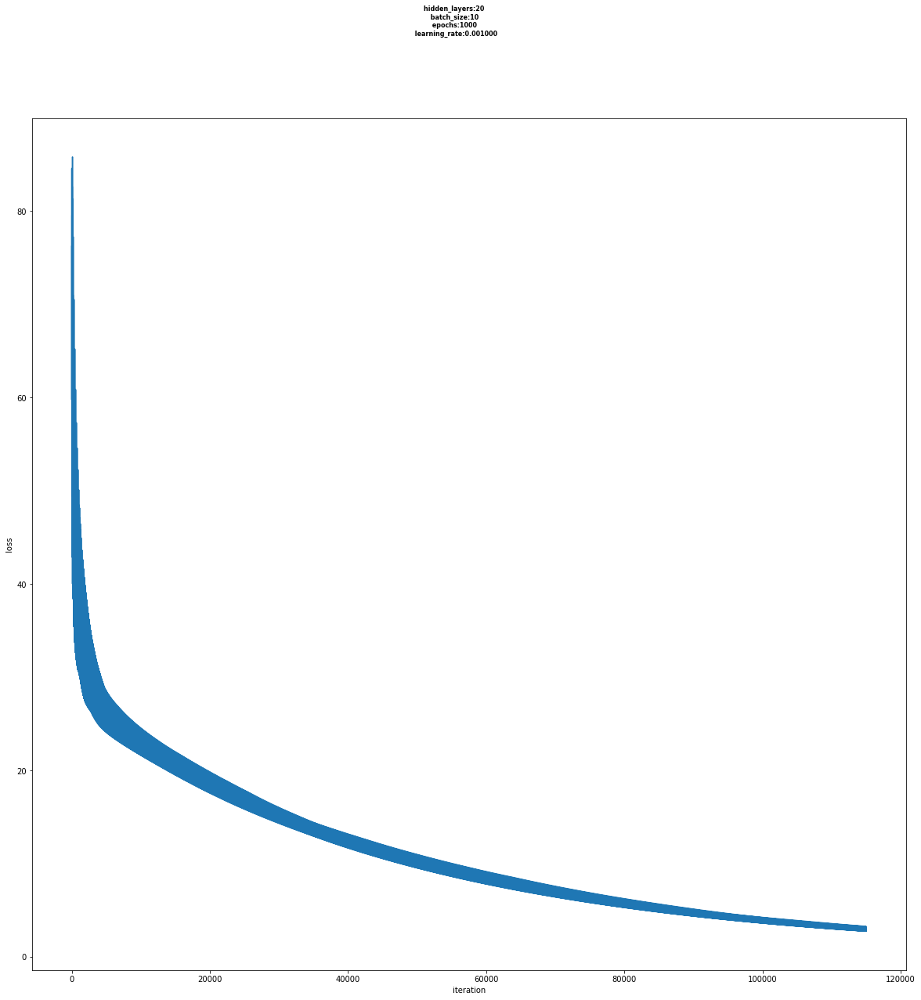

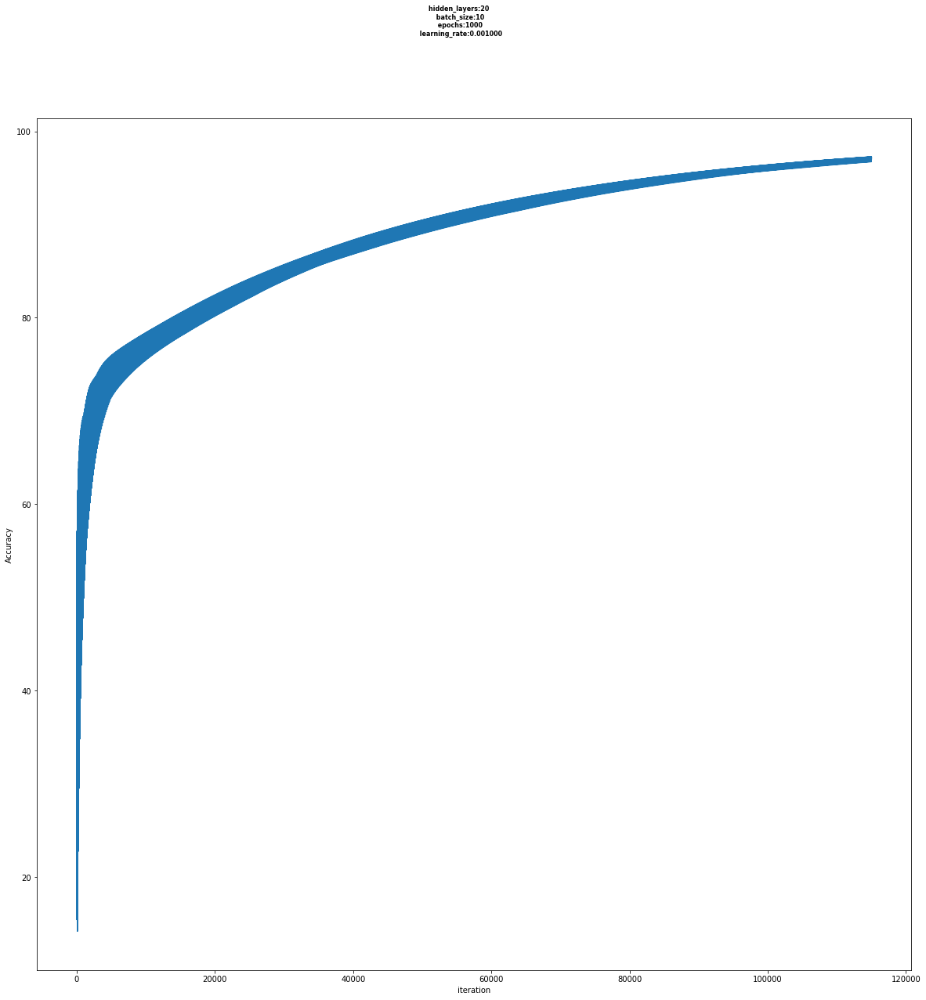

In [21]:
train_pred= network.predict(X_train)

In [22]:
acc_train = float(np.sum(np.argmax(train_pred, 1) == np.argmax(y_train,1))) / float(len(np.argmax(y_train,1)))       
print('Mean Train Accuracy:',acc_train*100)
print('Mean Train Error:',np.absolute(100-acc_train*100))

Mean Train Accuracy: 95.65217391304348
Mean Train Error: 4.347826086956516


Now I'll repeat the same process on the validation set:

In [23]:
network.train(X_valid,y_valid)

=== Epoch: 1/1000	Iteration:1	Loss: 2.82	Accuracy: 97.18 ===
=== Epoch: 1/1000	Iteration:11	Loss: 2.97	Accuracy: 97.03 ===
=== Epoch: 1/1000	Iteration:21	Loss: 3.20	Accuracy: 96.80 ===
=== Epoch: 1/1000	Iteration:31	Loss: 3.67	Accuracy: 96.33 ===
=== Epoch: 1/1000	Iteration:41	Loss: 3.16	Accuracy: 96.84 ===
=== Epoch: 1/1000	Iteration:51	Loss: 3.47	Accuracy: 96.53 ===
=== Epoch: 1/1000	Iteration:61	Loss: 3.07	Accuracy: 96.93 ===
=== Epoch: 1/1000	Iteration:71	Loss: 3.57	Accuracy: 96.43 ===
=== Epoch: 1/1000	Iteration:81	Loss: 2.82	Accuracy: 97.18 ===
=== Epoch: 1/1000	Iteration:91	Loss: 2.79	Accuracy: 97.21 ===
=== Epoch: 1/1000	Iteration:101	Loss: 3.01	Accuracy: 96.99 ===
=== Epoch: 1/1000	Iteration:111	Loss: 3.06	Accuracy: 96.94 ===
=== Epoch: 1/1000	Iteration:121	Loss: 3.14	Accuracy: 96.86 ===
=== Epoch: 1/1000	Iteration:131	Loss: 3.64	Accuracy: 96.36 ===
=== Epoch: 1/1000	Iteration:141	Loss: 2.89	Accuracy: 97.11 ===
=== Epoch: 1/1000	Iteration:151	Loss: 3.01	Accuracy: 96.99 ===
===

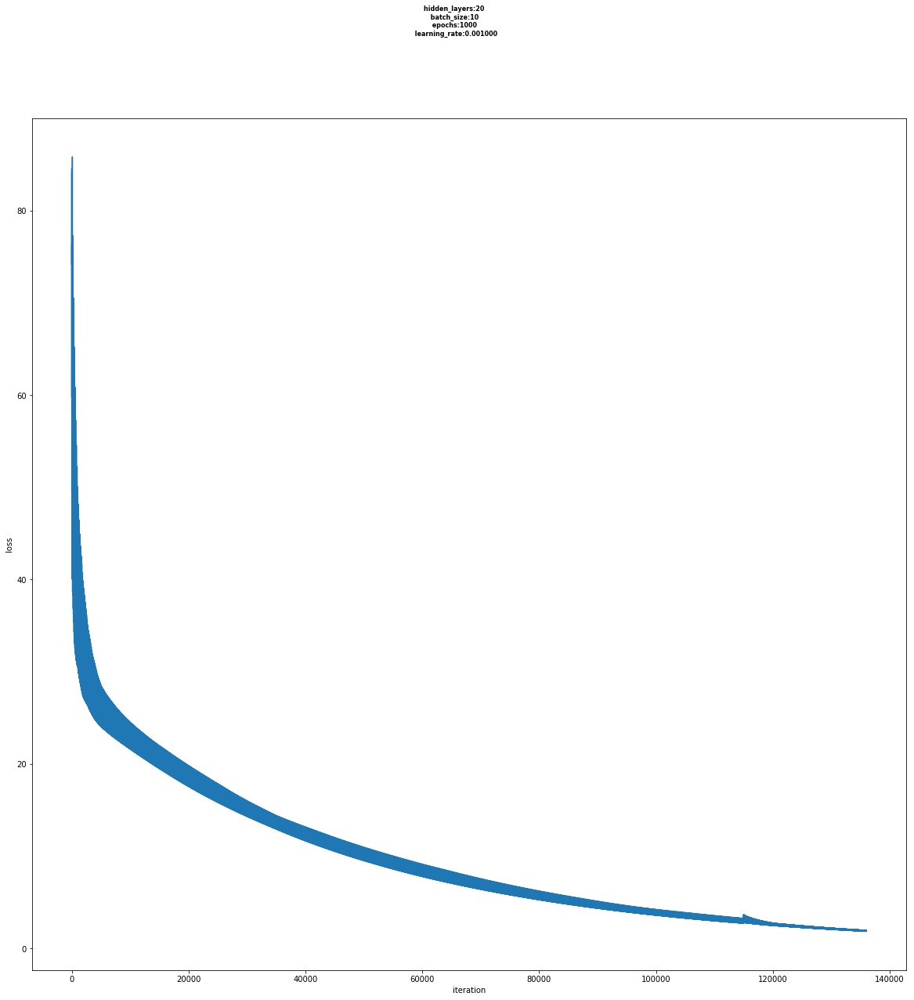

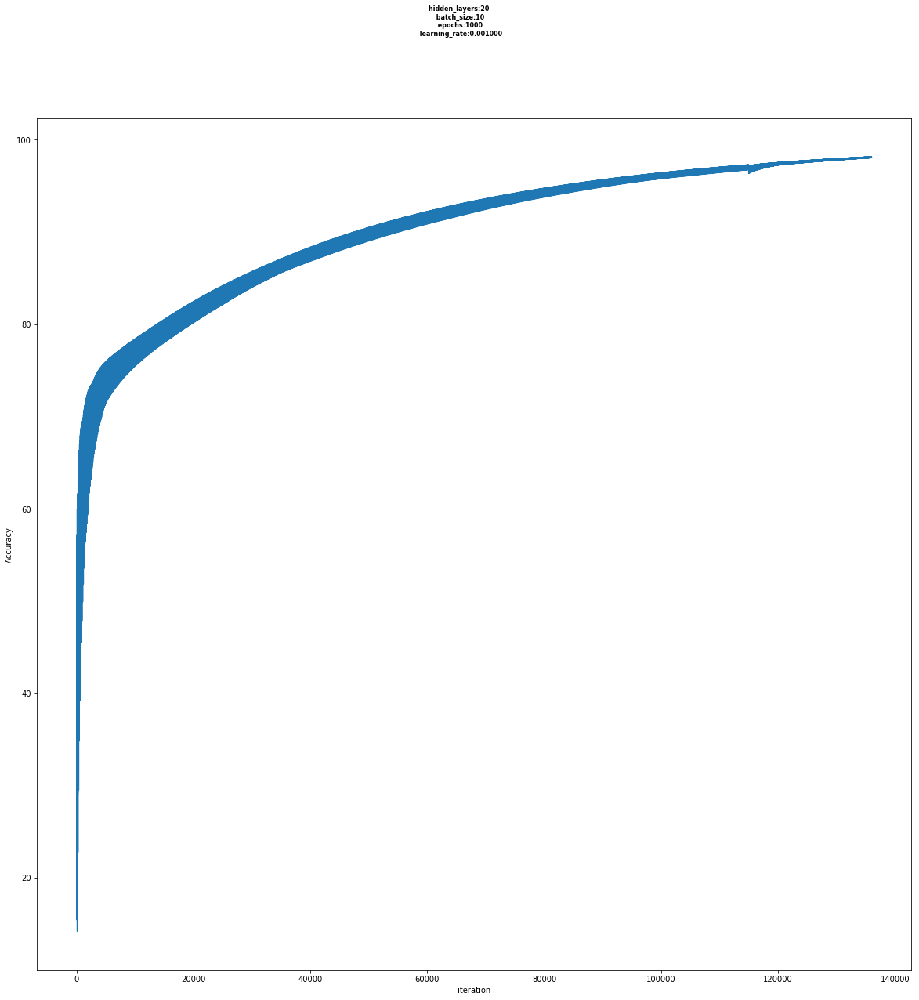

In [24]:
valid_pred= network.predict(X_valid)

In [25]:
acc_valid = float(np.sum(np.argmax(valid_pred, 1) == np.argmax(y_valid,1))) / float(len(np.argmax(y_valid,1)))       
print('Mean Train Accuracy:',acc_valid*100)
print('Mean Train Error:',np.absolute(100-acc_valid*100))

Mean Train Accuracy: 100.0
Mean Train Error: 0.0


In the last step, I'll predict the model using the test set, and calculate it's mean error and accuracy, and print it's confusion matrix.

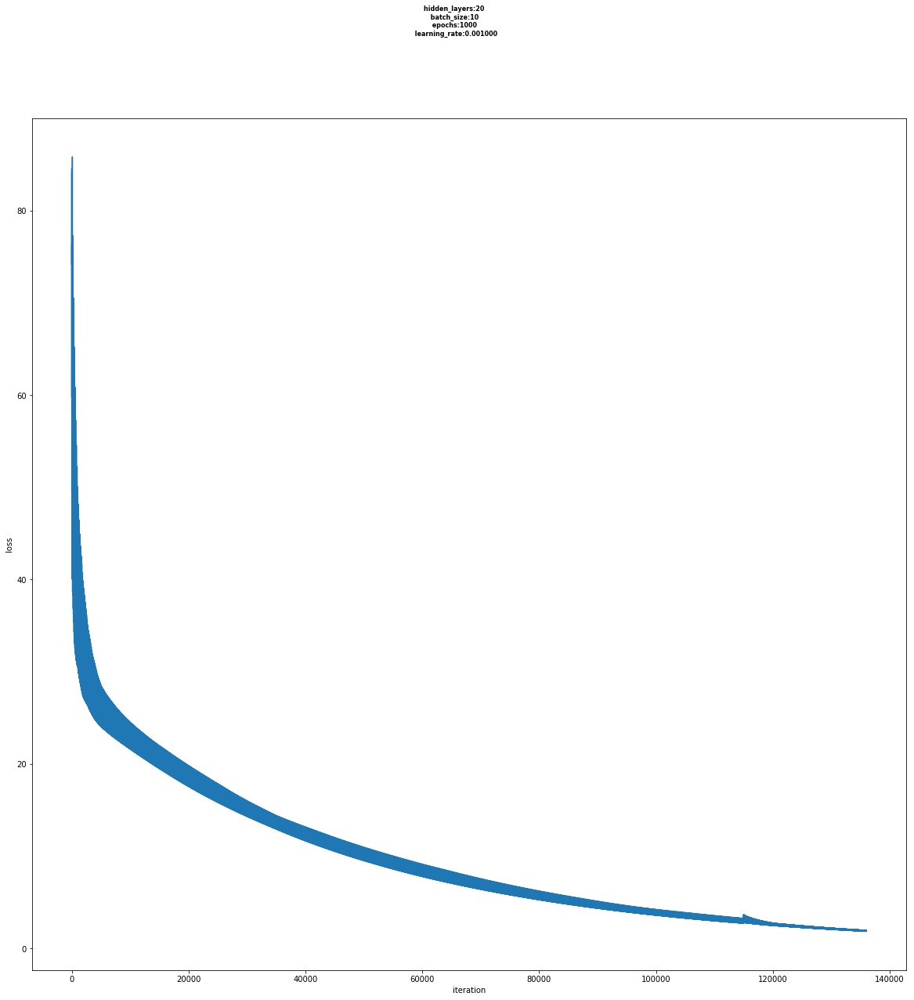

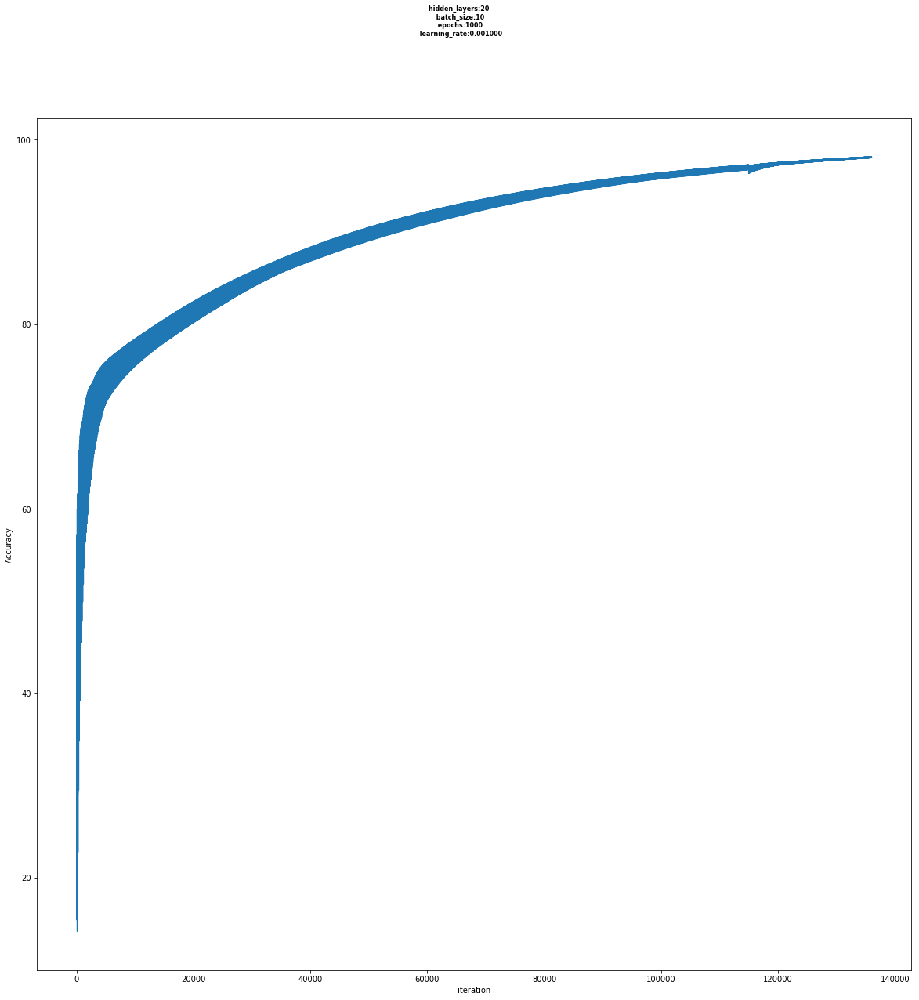

Mean Test Accuracy: 83.68200836820083
Mean Test Error: 16.317991631799174
Confusion Matrix:
[[22  0  0  0  0  0  0  0  1  0]
 [ 0 16  1  0  2  0  0  4  0  0]
 [ 0  0 19  0  0  0  1  1  5  0]
 [ 0  0  1 23  0  1  0  1  1  1]
 [ 0  0  0  0 21  0  2  0  0  0]
 [ 0  0  1  1  0 18  0  0  0  0]
 [ 0  0  0  0  1  0 21  0  0  0]
 [ 0  1  1  0  0  0  0 20  0  1]
 [ 0  0  0  1  0  1  0  1 20  2]
 [ 1  0  0  0  1  0  0  1  3 20]]


In [26]:
y_pred = network.predict(X_test)
acc = float(np.sum(np.argmax(y_pred, 1) == np.argmax(y_test,1))) / float(len(np.argmax(y_test,1)))       
print('Mean Test Accuracy:',acc*100)
print('Mean Test Error:',np.absolute(100-acc*100))
print('Confusion Matrix:')
print(confusion_matrix(np.argmax(y_test,1),np.argmax(y_pred,1))) 

<h3>Hyper Parameter Tuning Results</h3>

In this part, the results from different trial and errors are summarized. 
First, I tested the network using two layers and then three layers. Using three layers, the train accuracy was 90 and the validation accuracy was 71, but in two layers, the train accuracy was 96 and the validation accuracy was 85. So two layers is the optimal number of layers.

Next, the number of nodes in the hidden layer was tested. With 10 nodes, the accuracies were 89 and 84, with 20 they were 96 and 85, and for 30,40,50... they stayed the same. For 100 nodes, I had 100 and 82(which obviously meant overfitting), So 20 was the optimal number.

For the batch size,I tested 1,10,50 and 256. The less the number was,the accuracy was higher,but computations were extremely slow.The higher the size,the accuracies decreased and the computations became faster.E.g. for batch size of 1, I had the accuracies of 99 and 94,but everything was very slow.For 10, I had 96 and 85. For 50 it was 71 an 65,for 100 it was 49 and 43,and for 256 it was 39 and 36. So I chose 10 to be the batch size where I had good accuracies and acceptable computation speed.

Lastly, I tested all combinations of activation functions relu,softmax, and tanh together. That means that I tested networks with relu and relu,softmax and softmax,tanh and tanh, relu and softmax, relu and tanh,softmax and relu,softmax and tanh,tanh and relu,and tanh and softmax. 
The ones without softmax(specially as output function) gave very bad results,with both accuracies near 0. There were three combinations that had good results: softmax and softmax with accuracies of 88 and 85, and relu/softmax and tanh/softmax both with accuracies of 96 and 85. So I chose relu as the hidden function and softmax as the output function.

<h3>Keras</h3>

I implemented the network using Keras with the exact hyper parameters I found with tuning from the previous part and obtained a train accuracy of 100 and test accuracy of 90, so that was somewhat similar to the results from our original network from scratch. The file for keras is another seperate notebook named keras.ipynb and is included in the project folder.

<h1>Question 3</h1>

This question focuses on dimensionality reduction using the Principal Component Analysis(PCA)method and asks us to implement that on our data and repeat the training and testing using the reduced data.

First, a brief on PCA:

PCA is a method of dimentionality reduction used in cases where we have too many features(dimentions) and want to avoid the curse of dimentionality. PCA finds a set of new dimensions for the data points in such a way that all the dimensions are orthogonal(causing it to be linearly independent) and sorted according to the variance of the data. That means that the components having more variance are ranked first. 

Now we'll explain exactly what the algorithm does. First it calculates the covariance matrix(X) of the data samples. Then it calculates the eigen vectors and eigen values of X. It then sorts the eigen vectors according to their corresponding eigen values in a decreasing order. Then it chooses the first K eigen vectors(K is also a hyper parameter that we should specify)and so those K vectors are the new K dimensions(features)of the data. Lastly it transforms the original n dimensions to K dimensions and that's how the reduction occurs.      

In summary, PCA finds a projection of the data points that captures the largest amount of variance in data and preserves them. The data are projected into a very smaller space(dimension)and that results in dimensionality reduction. The K eigen vectors of the data are found and the those define the new dimensions.

<img src='PCA.PNG'>

Now it's time to apply PCA to our data. For that purpose we'll use sklearn's decomposition's PCA module:

In [27]:
from sklearn.decomposition import PCA

As we saw in the explanations above, the number of components(or the dimensions we want to have) is a hyper parameter not known from before and should be specified by us. We may not know what the efficient number is, so a way to solve that is to build a pca object, and specify the number of components to be a number between 0 and 1. According to sklearn's documentation when this is done, the number of components is estimated by the algorithm from the input data. So that's what we'll do. The number I've specified is 0.95: 

In [28]:
print('Original X shape: ',X.shape)

Original X shape:  (1593, 256)


In [29]:
pca = PCA(0.95)
projected = pca.fit(X)
print(pca.n_components_)

161


This means that the number of components should be 161. So now we'll apply PCA with 161 components and do a reduction:

In [30]:
X= pca.transform(X)
print('X shape after PCA:',X.shape)

X shape after PCA: (1593, 161)


So now we have 161 features or dimensions instead of 256. Now let's repeat the train and prediction processes from Question 2 with the slight difference that now the number of input nodes for the network are 161:

In [31]:
X_train1, X_test, y_train1, y_test = train_test_split(X, y, test_size=0.15, random_state=42)
X_train,X_valid,y_train,y_valid = train_test_split(X_train1,y_train1,test_size=0.15,random_state=42 )

In [43]:
network2 =  Network(
                 num_nodes_in_layers = [161, 20, 10],
                 batch_size = 10,
                 num_epochs = 1000,
                 learning_rate = 0.001,
                 weights_file = 'weights.pkl'
             )

In [44]:
network2.train(X_train,y_train)

=== Epoch: 1/1000	Iteration:1	Loss: 43.62	Accuracy: 56.38 ===
=== Epoch: 1/1000	Iteration:11	Loss: 53.50	Accuracy: 46.50 ===
=== Epoch: 1/1000	Iteration:21	Loss: 45.71	Accuracy: 54.29 ===
=== Epoch: 1/1000	Iteration:31	Loss: 61.26	Accuracy: 38.74 ===
=== Epoch: 1/1000	Iteration:41	Loss: 48.35	Accuracy: 51.65 ===
=== Epoch: 1/1000	Iteration:51	Loss: 61.52	Accuracy: 38.48 ===
=== Epoch: 1/1000	Iteration:61	Loss: 50.12	Accuracy: 49.88 ===
=== Epoch: 1/1000	Iteration:71	Loss: 48.60	Accuracy: 51.40 ===
=== Epoch: 1/1000	Iteration:81	Loss: 49.46	Accuracy: 50.54 ===
=== Epoch: 1/1000	Iteration:91	Loss: 53.74	Accuracy: 46.26 ===
=== Epoch: 1/1000	Iteration:101	Loss: 53.53	Accuracy: 46.47 ===
=== Epoch: 1/1000	Iteration:111	Loss: 40.68	Accuracy: 59.32 ===
=== Epoch: 1/1000	Iteration:121	Loss: 61.61	Accuracy: 38.39 ===
=== Epoch: 1/1000	Iteration:131	Loss: 45.30	Accuracy: 54.70 ===
=== Epoch: 1/1000	Iteration:141	Loss: 66.28	Accuracy: 33.72 ===
=== Epoch: 1/1000	Iteration:151	Loss: 44.43	Accurac

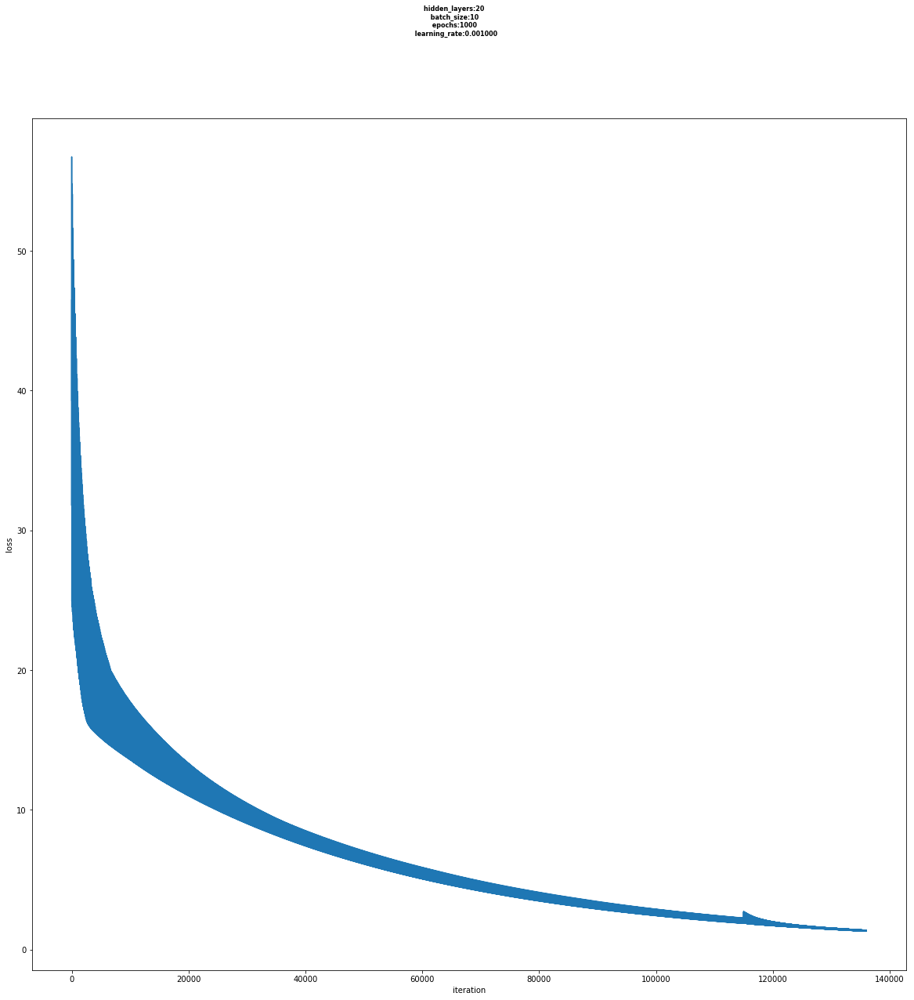

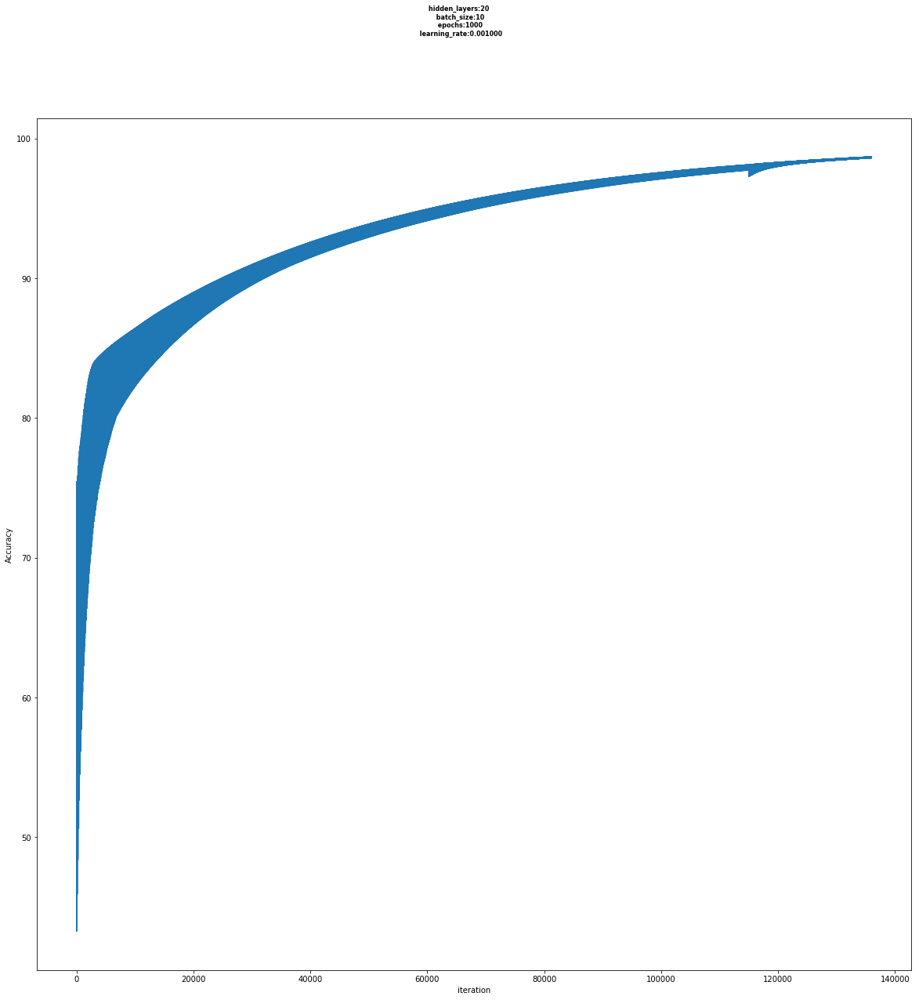

In [45]:
train_pred= network2.predict(X_train)

In [46]:
acc_train = float(np.sum(np.argmax(train_pred, 1) == np.argmax(y_train,1))) / float(len(np.argmax(y_train,1)))       
print('Mean Train Accuracy:',acc_train*100)
print('Mean Train Error:',np.absolute(100-acc_train*100))

Mean Train Accuracy: 98.0
Mean Train Error: 2.0


In [47]:
network2.train(X_valid,y_valid)

=== Epoch: 1/1000	Iteration:1	Loss: 1.80	Accuracy: 98.20 ===
=== Epoch: 1/1000	Iteration:11	Loss: 2.20	Accuracy: 97.80 ===
=== Epoch: 1/1000	Iteration:21	Loss: 2.01	Accuracy: 97.99 ===
=== Epoch: 1/1000	Iteration:31	Loss: 2.24	Accuracy: 97.76 ===
=== Epoch: 1/1000	Iteration:41	Loss: 2.01	Accuracy: 97.99 ===
=== Epoch: 1/1000	Iteration:51	Loss: 2.76	Accuracy: 97.24 ===
=== Epoch: 1/1000	Iteration:61	Loss: 1.88	Accuracy: 98.12 ===
=== Epoch: 1/1000	Iteration:71	Loss: 2.35	Accuracy: 97.65 ===
=== Epoch: 1/1000	Iteration:81	Loss: 1.96	Accuracy: 98.04 ===
=== Epoch: 1/1000	Iteration:91	Loss: 2.36	Accuracy: 97.64 ===
=== Epoch: 1/1000	Iteration:101	Loss: 1.87	Accuracy: 98.13 ===
=== Epoch: 1/1000	Iteration:111	Loss: 2.23	Accuracy: 97.77 ===
=== Epoch: 1/1000	Iteration:121	Loss: 2.11	Accuracy: 97.89 ===
=== Epoch: 1/1000	Iteration:131	Loss: 2.36	Accuracy: 97.64 ===
=== Epoch: 1/1000	Iteration:141	Loss: 2.13	Accuracy: 97.87 ===
=== Epoch: 1/1000	Iteration:151	Loss: 1.88	Accuracy: 98.12 ===
===

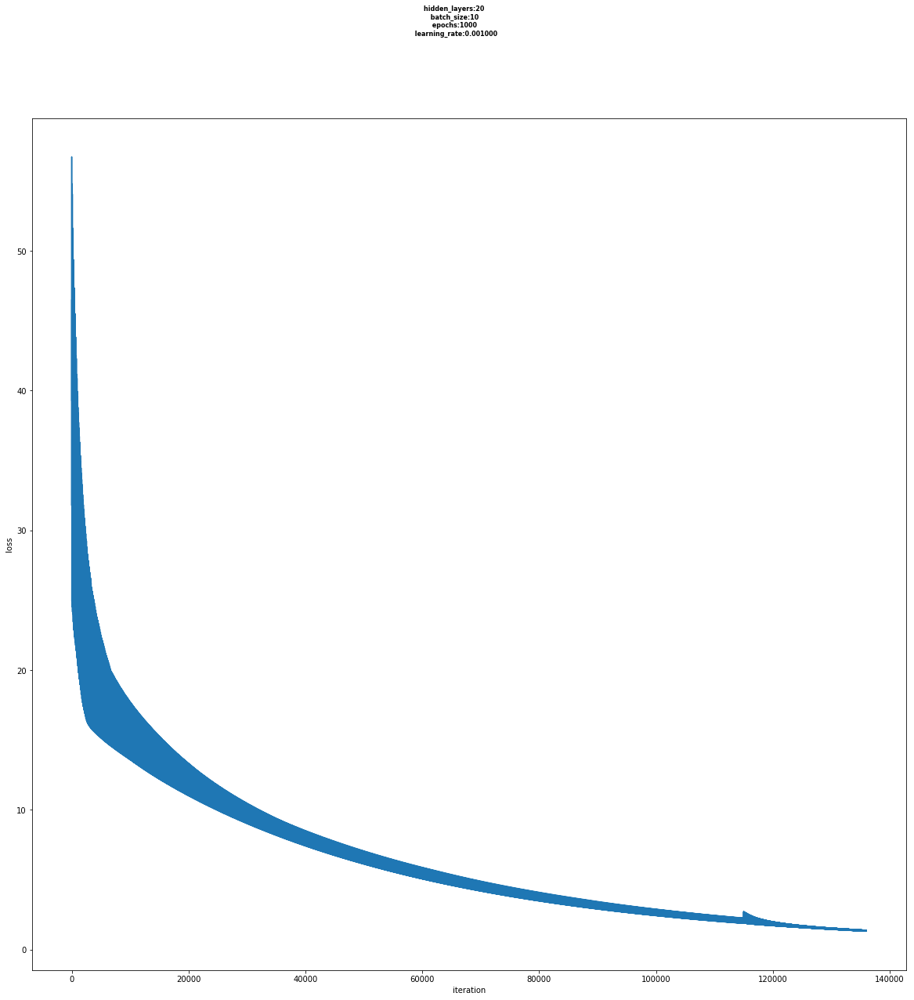

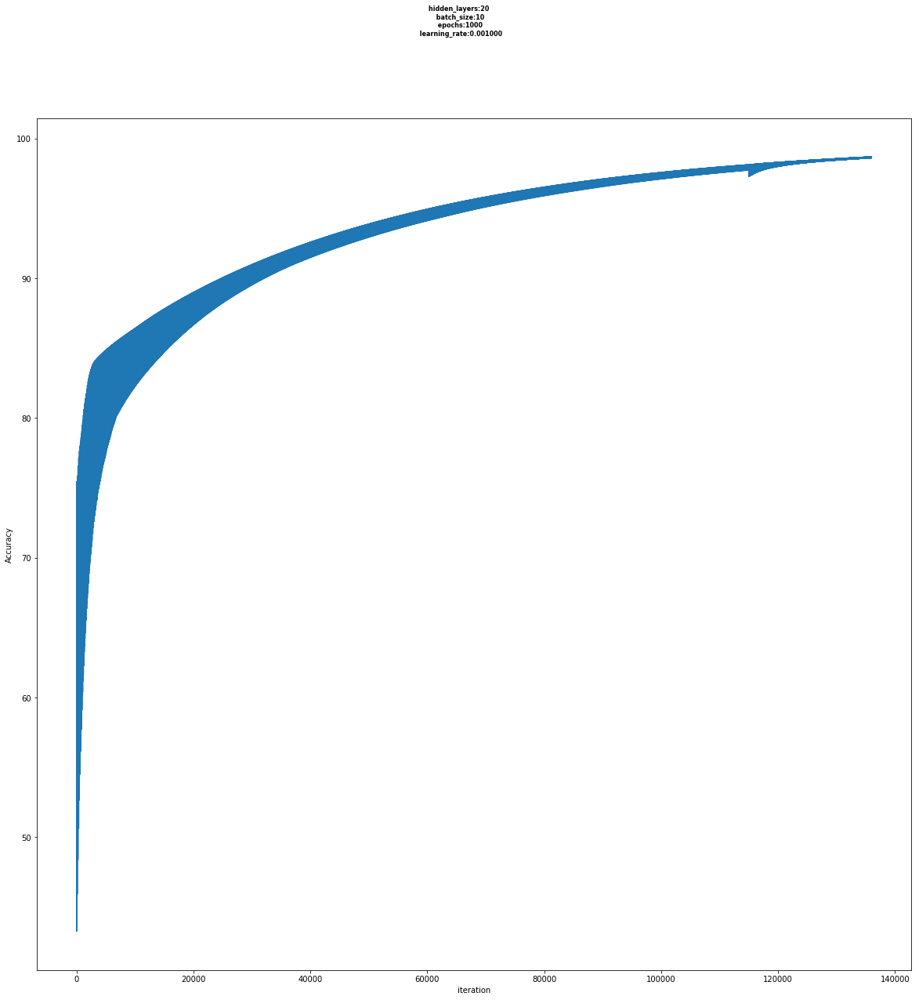

In [39]:
valid_pred= network2.predict(X_valid)

In [48]:
acc_valid = float(np.sum(np.argmax(valid_pred, 1) == np.argmax(y_valid,1))) / float(len(np.argmax(y_valid,1)))       
print('Mean Train Accuracy:',acc_valid*100)
print('Mean Train Error:',np.absolute(100-acc_valid*100))

Mean Train Accuracy: 100.0
Mean Train Error: 0.0


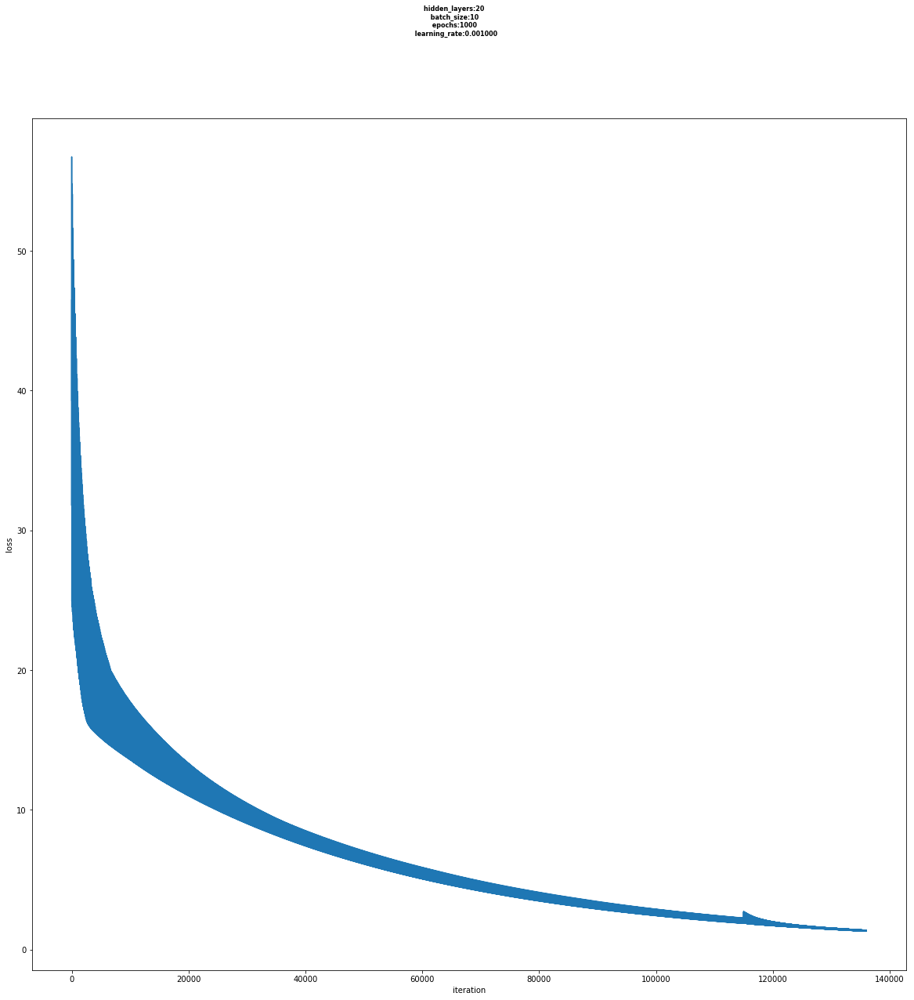

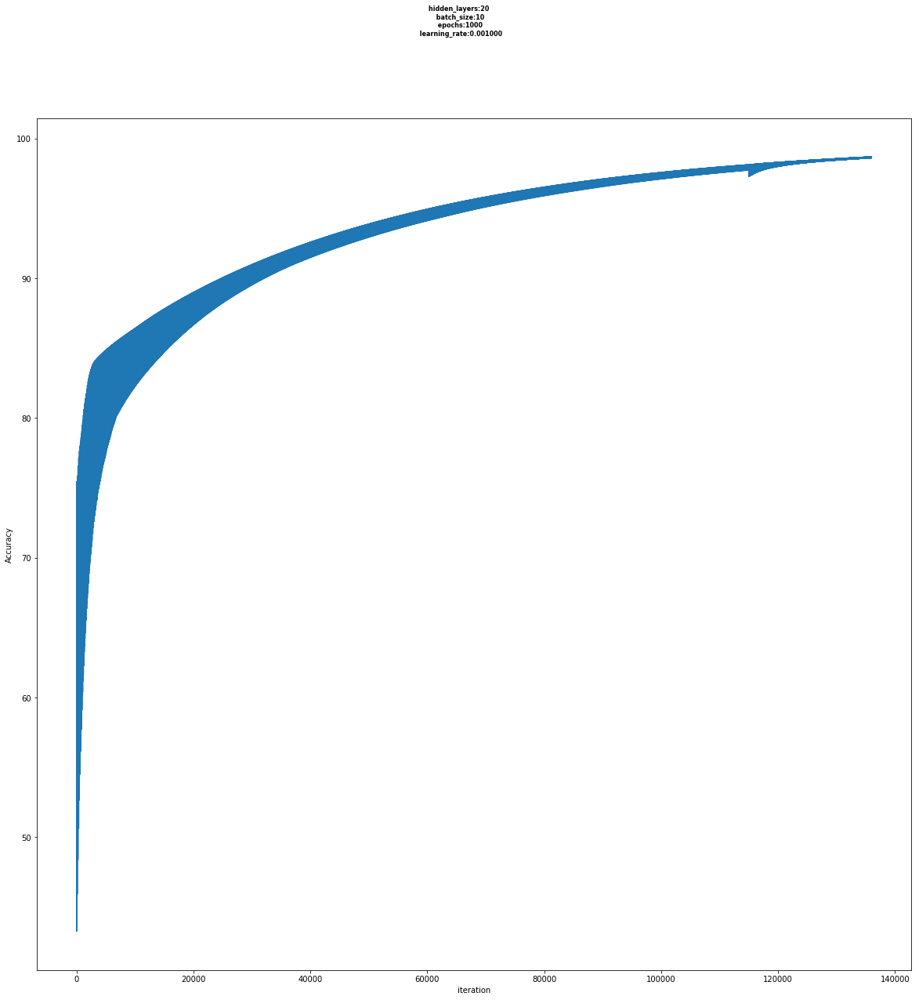

Mean Test Accuracy: 88.28451882845188
Mean Test Error: 11.71548117154812
Confusion Matrix:
[[20  0  0  0  0  0  2  0  1  0]
 [ 0 17  1  0  1  0  0  4  0  0]
 [ 0  1 21  0  1  0  1  0  2  0]
 [ 0  0  1 26  0  0  0  0  0  1]
 [ 0  0  0  0 21  0  2  0  0  0]
 [ 0  0  1  1  0 18  0  0  0  0]
 [ 0  0  0  0  1  0 21  0  0  0]
 [ 0  3  0  0  0  0  0 20  0  0]
 [ 0  0  1  0  0  0  0  0 22  2]
 [ 1  0  0  0  0  0  0  0  0 25]]


In [49]:
y_pred = network2.predict(X_test)
acc = float(np.sum(np.argmax(y_pred, 1) == np.argmax(y_test,1))) / float(len(np.argmax(y_test,1)))       
print('Mean Test Accuracy:',acc*100)
print('Mean Test Error:',np.absolute(100-acc*100))
print('Confusion Matrix:')
print(confusion_matrix(np.argmax(y_test,1),np.argmax(y_pred,1))) 

Compared to Question 2 where the train and test accuracies where 95 and 84, now we have train and test accuracies of 98 and 88 which are higher. So PCA is really helpful when we have many dimensions and want to improve the accuracy and the overall process of the model and also decrease the amount of tedious computations in each epoch.